## 1. Download dei dati ##

In [1]:
# Download dataset
#!wget https://www.zemris.fer.hr/projects/LicensePlates/english/baza_slika.zip
# Unzip file zip
#!unzip -o -j baza_slika.zip "*.jpg" -d dataset

## 2. Preparazione dei dati ##

In [2]:
import os

import gc
import matplotlib.pyplot as plt
import numpy as np
import random

from PIL import Image
from skimage.transform import rescale
from skimage.util import view_as_windows, random_noise
from torch.utils.data import DataLoader, random_split

In [3]:
# Percorso alla cartella che contiene le immagini
datasetPath = "dataset"

# Lista per salvare le immagini caricate
imgList = []

# Scorrimento di tutti i file nella cartella
i = 0
for fileName in os.listdir(datasetPath):
    if fileName.lower().endswith(".jpg"):
        filePath = os.path.join(datasetPath, fileName)
        img = np.array(Image.open(filePath)).astype(np.float32) / 255.0
        img = rescale(img, (1/1.66, 1/1.66, 1)) # Passaggio da 640x480 a 386x289
        imgList.append(img)

In [4]:
# Creazione rumore
def addNoise(img, intensity=0.2):
    # Scelgo casualmente se applicare un rumore sale e pepe o uno gaussiano
    randInt = random.randint(1,4) 
    h,w,c = img.shape
    y = np.zeros_like(img)
    if randInt == 1:                    # Rumore gaussiano
        d = random.randint(10, 25)/255
        n = d*np.random.randn(h,w,c)
        y = img+n
    elif randInt == 2:                  # Rumore sale e pepe
        sp = random_noise(img, mode="s&p")
        y = img*sp
    elif randInt == 3:                  # Rumore poisson
        poi = random_noise(img, mode="poisson")
        y = img*poi
    else:                               # Rumore speckle
        n = np.random.randn(h,w,c) 
        y = img + img*n*intensity            
    
    if y.max() > 1.0:
        y[y > 1.0] = 1.0
    if y.min() < 0.0:
        y[y < 0.0] = 0.0
    
    return y


In [5]:
from torch.utils.data import Dataset
import torch
from torchvision import transforms
import numpy as np

class ImgListDataset(Dataset):
    def __init__(self, imgList):
        self.imgList = imgList
        self.target_size = (289, 386)  # Altezza, larghezza desiderata
        self.transform = transforms.Compose([
            transforms.ToPILImage(),
            transforms.Resize(self.target_size),
            transforms.ToTensor()
        ])

    def __len__(self):
        return len(self.imgList)

    def __getitem__(self, idx):
        img = self.imgList[idx]
        if isinstance(img, np.ndarray):
            img = self.transform(img)
        return img



In [6]:
# Divisione dell'intero dataset in training set, validation set e test set (Circa 80%, 10% e 10%)
trainSet, valSet, testSet = random_split(imgList, [0.8, 0.1, 0.1])

#windowShape = (96,96,3)
#scale = 0.5
#step = 24

# Creazione dei dataset di immagini ricostruite (downscale-upscale)
trainSetNoise = []
valSetNoise = []
testSetNoise = []

for el in trainSet:
    imgNoise = addNoise(el)
    trainSetNoise.append(imgNoise)

for el in valSet:
    imgNoise = addNoise(el)
    valSetNoise.append(imgNoise)

for el in testSet:
    imgNoise = addNoise(el)
    testSetNoise.append(imgNoise)

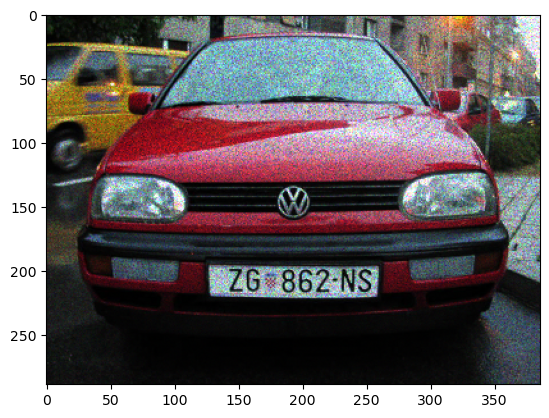

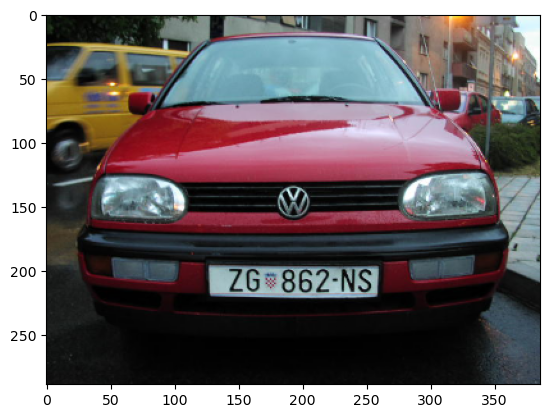

In [7]:
plt.figure()
plt.imshow(imgNoise)

plt.figure()
plt.imshow(el)

In [8]:
# Creazione dei DataLoader per i set
batchSize = 6
numWorkers = 4

# Dataloader per le immagini originali
trainSetDataset = ImgListDataset(trainSet)
valSetDataset = ImgListDataset(valSet)
testSetDataset = ImgListDataset(testSet)

trainDataload = DataLoader(trainSetDataset, batch_size=batchSize, num_workers=numWorkers)
valDataload = DataLoader(valSetDataset, batch_size=batchSize, num_workers=numWorkers)
testDataload = DataLoader(testSetDataset, batch_size=batchSize, num_workers=numWorkers)

# Dataloader per le immagini originali
trainSetRicDataset = ImgListDataset(trainSetNoise)
valSetRicDataset = ImgListDataset(valSetNoise)
testSetRicDataset = ImgListDataset(testSetNoise)

trainDataloadNoise = DataLoader(trainSetRicDataset, batch_size=batchSize, num_workers=numWorkers)
valDataloadNoise = DataLoader(valSetRicDataset, batch_size=batchSize, num_workers=numWorkers)
testDataloadNoise = DataLoader(testSetRicDataset, batch_size=batchSize, num_workers=numWorkers)

print("Effettuata suddivisione:")
print(f"- Training-set: {len(trainSet)} campioni.")
print(f"- Validation-set: {len(valSet)} campioni.")
print(f"- Test-set: {len(testSet)} campioni.")
print(f"- Training-set Noise: {len(trainSetNoise)} campioni.")
print(f"- Validation-set Noise: {len(valSetNoise)} campioni.")
print(f"- Test-set Noise: {len(testSetNoise)} campioni.")

Effettuata suddivisione:
- Training-set: 403 campioni.
- Validation-set: 50 campioni.
- Test-set: 50 campioni.
- Training-set Noise: 403 campioni.
- Validation-set Noise: 50 campioni.
- Test-set Noise: 50 campioni.


## 3. Architettura ##

In [ ]:
import torch
import torch.nn as nn

class DnCNN(nn.Module):
    def __init__(self, in_channels=3, out_channels=64, kernel_size=3, padding=1):
        super(DnCNN, self).__init__()
        layers = []
            # Primo blocco convoluzionale
            # in_channel = 3 poichè 3 canali
            # out_channel = 64 come scritto nella traccia (num feat)
            # kernel_size = 3 come scritto nella traccia (dim spaziale 3x3)

        # Iter 1: Convolution + ReLU
        layers.append(nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, padding=padding))
        layers.append(nn.ReLU())

        # Iters 2-16: Convolution + BatchNorm + ReLU
        for i in range(18):
            layers.append(nn.Conv2d(in_channels=out_channels, out_channels=out_channels, kernel_size=kernel_size, padding=padding))
            layers.append(nn.BatchNorm2d(out_channels))                    # Corrisponde al numero di canali di output del livello precedente
            layers.append(nn.ReLU())

        # Iters 17: Convolution
        layers.append(nn.Conv2d(in_channels=out_channels, out_channels=in_channels, kernel_size=kernel_size, padding=padding))

        # *layers corrisponde a layers[0],layers[1],..., quindi già spalmati come singoli elementi
        self.features = nn.Sequential(*layers)

        self.apply(self.kernel_initializer)

    def forward(self, x):
        return self.features(x)

    # Equivalente a kernel_inizializer="Orthogonal" in pytorch
    def kernel_initializer(self, module):
        if isinstance(module, nn.Conv2d):
            nn.init.orthogonal_(module.weight)


## 4. Addestramento ##

In [10]:
# Librerie
import time

In [11]:
# Abilitiamo il dispositivo GPU per il training
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

In [12]:
# Criterion deve essere torch.nn.MSELoss(size_average=None, reduce=None, reduction='mean')
# Legenda dataloader:
#   - dlTrain = immagini originali training
#   - dlTrainNoise = immagini ricostruite (downscalate-upscalate) training
#   - dlVal = immagini originali validation
#   - dlValNoise = immagini ricostruite (downscalate-upscalate) validation
def training (dlTrain, dlTrainNoise, dlVal, dlValNoise, numEpoch, model, criterion, optimizer, bestMse, bestPsnr, bestEpoch, outputPath, accumulation_steps=1):

    # Liste dei risultati definite per la visualizzazione
    MSETrainList = []
    MSEValList = []
    PSNRTrainList = []
    PSNRValList = []

    # Iterazione per ogni epoch
    for epoch in range(numEpoch):
        #accumulation_steps = adjust_accumulation_steps(target_memory, accumulation_steps)
        model.cuda()
        # Conteggio del tempo per misurare la durata di un'epoca
        since = time.time()

        # Inizializzazione delle variabili
        modelMseTrain = 0.0
        totalSize = 0

        # Modello impostato in traning mode
        model.train()

        # Iterazione per ogni batch
        # Devo iterare su i 2 dataloader contemporaneamente, per fare ciò utilizzo zip
        for (inputsTrain, inputsNoise) in zip(dlTrain, dlTrainNoise):

            # Converto gli input in tensori float e li carico nella GPU
            inputsTrain = inputsTrain.type(torch.FloatTensor).cuda()
            inputsNoise = inputsNoise.type(torch.FloatTensor).cuda()

            # Reset dei gradienti, altrimenti i vecchi gradienti sono sommati ai nuovi, piuttosto
            # che essere sovrascritti
            optimizer.zero_grad()
            model.zero_grad()

            # Calcolo dettagli
            #y = model(inputsNoise)
            yTrain = model(inputsNoise)
            y = inputsNoise - yTrain

            # Calcolo della MSE
            loss = criterion(y, inputsTrain)
            # size(0) restituisce il numero di campioni nel batch, quindi si sta moltiplicando la loss
            # media per il numero di elementi per ottenere la somma totale della loss
            modelMseTrain += loss.item() * inputsTrain.size(0)
            totalSize += inputsTrain.size(0)

            # Calcolando il gradiente del tensore attuale
            loss.backward()

            optimizer.step()  # Update parameters
            optimizer.zero_grad()  # Clear gradients for the next accumulation cycle
            

        # Calcolo della MSE medio e del PSNR medio  dell'epoch
        modelMseEpochTrain = modelMseTrain/totalSize
        modelPsnrEpochTrain = 10 * torch.log10(torch.tensor(1/modelMseEpochTrain))

        # Salvataggio dei pesi per ogni iterazione
        # torch.save(model.state_dict(), outputPath + "train_weights.pth")

        # Modello impostato in validation mode
        model.eval()

        # Inizializzazione delle variabili
        modelMseVal = 0.0
        totalSizeVal = 0

        with torch.no_grad():               # Disattiva il calcolo dei gradienti
        # Iterazione per ogni bach
        # Devo iterare su i 2 dataloader contemporaneamente, per fare ciò utilizzo zip
            for (inputsVal, inputsValNoise) in zip(dlVal, dlValNoise):

                # Converto gli input in tensori float e li carico nella GPU
                inputsVal = inputsVal.type(torch.FloatTensor).cuda()
                inputsValNoise = inputsValNoise.type(torch.FloatTensor).cuda()

                # Calcolo dettagli
                yVal = model(inputsValNoise)
                y = inputsValNoise - yVal 

                # Calcolo della MSE
                loss = criterion(y, inputsVal)
                # size(0) restituisce il numero di campioni nel batch, quindi si sta moltiplicando la loss
                # media per il numero di elementi per ottenere la somma totale della loss
                modelMseVal += loss.item() * inputsVal.size(0)
                totalSizeVal += inputsVal.size(0)

            # Calcolo della MSE medio e del PSNR medio  dell'epoch
            modelMseEpochVal = modelMseVal/totalSizeVal
            modelPsnrEpochVal = 10 * torch.log10(torch.tensor(1/modelMseEpochVal))
            timeElapsed = time.time()-since

        print('[Epoch %d][Train on %d [MSE: %.4f  PSNR: %.4f]][Val on %d [MSE: %.4f  PSNR: %.4f]][Time: %.0f m %.0f s]'
                %(epoch, totalSize, modelMseEpochTrain, modelPsnrEpochTrain, totalSizeVal, modelMseEpochVal,
                modelPsnrEpochVal, timeElapsed // 60, timeElapsed % 60))

        # Salvaggio dei risultati migliori
        if (modelMseEpochVal < bestMse):
            print("-------Saving best weights-------")
            bestMse = modelMseEpochVal
            bestPsnr = modelPsnrEpochVal
            bestEpoch = epoch
            # Salvataggio dei migliori risultati
            try:
                torch.save(model.cpu().state_dict(), outputPath)
                print("-------Best weights saved-------")
            except Exception as e:
                print("Error:", e)

        # Salvataggio dei risultati per la visualizzazione
        MSETrainList.append(modelMseEpochTrain)
        MSEValList.append(modelMseEpochVal)
        PSNRTrainList.append(modelPsnrEpochTrain)
        PSNRValList.append(modelPsnrEpochVal)

    return bestMse, bestPsnr, MSETrainList, MSEValList, PSNRTrainList, PSNRValList




In [13]:
# Funzione di testing

def testing (dlTest, dlTestNoise, model, criterion, weightPath):

    # Caricamento dei pesi
    model.load_state_dict(torch.load(weightPath, map_location=torch.device("cpu")))
    model.cuda()


    # Conteggio del tempo per misurare la durata di un'epoca
    since = time.time()

    # Inizializzazione delle variabili
    modelMseTest = 0.0
    totalSize = 0
    outputsTest = []


    #model.load_state_dict(torch.load(weightPath , map_location=device))
    model.eval()

    # Iterazione su batch
    with torch.no_grad():               # Disattiva il calcolo dei gradienti
        for (inputsTest, inputsTestNoise) in zip(dlTest, dlTestNoise):


            # Converto gli input in tensori float e li carico nella GPU
            inputsTest = inputsTest.type(torch.FloatTensor).cuda()
            inputsTestNoise = inputsTestNoise.type(torch.FloatTensor).cuda()

            # Calcolo dettagli e ricostruzione immagine
            yTest = model(inputsTestNoise)
            y = inputsTestNoise - yTest
            outputsTest.append(y)

            # Calcolo della MSE
            loss = criterion(y, inputsTest)
            # size(0) restituisce il numero di campioni nel batch, quindi si sta moltiplicando la loss
            # media per il numero di elementi per ottenere la somma totale della loss
            modelMseTest += loss.item() * inputsTest.size(0)
            totalSize += inputsTest.size(0)


        # Calcolo della MSE medio e del PSNR medio  dell'epoch
        modelMseEpochTest = modelMseTest/totalSize
        modelPsnrEpochTest = 10 * torch.log10(torch.tensor(1/modelMseEpochTest))
        timeElapsed = time.time()-since

        print("[Test] [MSE: %.4f  PSNR: %.4f] [Time: %.0f m %.0f s]"
          %(modelMseEpochTest, modelPsnrEpochTest, timeElapsed // 60, timeElapsed % 60))

        return outputsTest

## 5. Valutazione delle prestazioni ##

In [14]:
def graphVisualization(MseModelTrain, MseModelVal, PSNRModelTrain, PSNRModelVal):

    # Visualizzazione delle liste come subplot
    fig, ax = plt.subplots(2, 1, figsize=(4, 5), constrained_layout=True)

    # Visualizzazione di MSE Training vs Validation
    ax[0].set_xlabel("Epoch", fontsize=10)
    ax[0].set_ylabel("MSE", fontsize=10)
    ax[0].set_title("MSE Training vs Validation", fontsize=10)
    ax[0].plot(range(len(MseModelTrain)), MseModelTrain, color="r", marker="o", label="Training MSE")
    ax[0].plot(range(len(MseModelVal)), MseModelVal, color="b", marker="o", label="Validation MSE")
    ax[0].set_xlim([0, max(len(MseModelTrain), len(MseModelVal))-0.5])
    ax[0].set_ylim([0.02, 0.2])
    ax[0].legend()
    ax[0].grid(True)

    # Visualizzazione di PSNR Training vs Validation
    ax[1].set_xlabel("Epoch", fontsize=10)
    ax[1].set_ylabel("PSNR", fontsize=10)
    ax[1].set_title("PSNR Training vs Validation", fontsize=10)
    ax[1].plot(range(len(PSNRModelTrain)), PSNRModelTrain, color="r", marker="o", label="Training PSNR")
    ax[1].plot(range(len(PSNRModelVal)), PSNRModelVal, color="b", marker="o", label="Validation PSNR")
    ax[1].set_xlim([0, max(len(PSNRModelTrain), len(PSNRModelVal))-0.5])
    ax[1].set_ylim([50, 100])
    ax[1].legend()
    ax[1].grid(True)

    plt.show()



In [15]:
# Iper parametri
epochList = [60]
learningRateList = [0.01, 0.001, 0.0001]


In [16]:
# Main
import torch.optim as optim

model = DnCNN().cuda()
criterion = torch.nn.MSELoss(size_average=None, reduce=None, reduction='mean')

bestMSEComb = 9000000000000000000.0              # Miglior MSE tra tutte le combinazioni
bestPSNRComb = -900000000000000000.0             # Miglior PSNR tra tutte le combinazioni

weightPath = "best_weights_generic_denoise.pth"
weightPathComb = "best_weights_generic_denoise_lr.pth"



In [17]:

# Training
for numEpoch in epochList:
    for lr in learningRateList:
        optimizer = optim.Adam(model.parameters(), lr=lr)

        bestMse = 9000000000000000000.0             # Miglior MSE della singola combinazione
        bestPsnr = -900000000000000000.0            # Miglior PSNR della singola combinazione
        bestEpoch = -1

        accumulationSteps = 10 # Simulation of batchsize = 60

        bestMSES, bestPSNRS, MSETrainList, MSEValList, PSNRTrainList, PSNRValList = training (trainDataload, trainDataloadNoise, valDataload, valDataloadNoise, numEpoch, model, criterion, optimizer, bestMse, bestPsnr, bestEpoch, weightPath, accumulationSteps)

        # Aggiorno i valori di miglior MSE
        if bestMSES < bestMSEComb:
            bestMSEComb = bestMSES
            bestPSNRComb = bestPSNRS
            # Caricamento dei pesi
            torch.save(model.cpu().state_dict(), weightPathComb)
            print(f"------Best Combination saved [Epoch: {numEpoch} - Learning Rate: {lr}]-------")
            model.cuda()

        #graphVisualization(MSETrainList, MSEValList, PSNRTrainList, PSNRValList)

print(f"Best MSE: {bestMSEComb}")
print(f"Best PSNR: {bestPSNRComb}")





OutOfMemoryError: CUDA out of memory. Tried to allocate 164.00 MiB. GPU 0 has a total capacity of 7.92 GiB of which 75.19 MiB is free. Process 108438 has 24.14 MiB memory in use. Process 354916 has 5.60 GiB memory in use. Process 528246 has 1.10 GiB memory in use. Of the allocated memory 1001.49 MiB is allocated by PyTorch, and 6.51 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

[Test] [MSE: 0.0005  PSNR: 33.0744] [Time: 0 m 3 s]


/tmp/ipykernel_94/2666293790.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


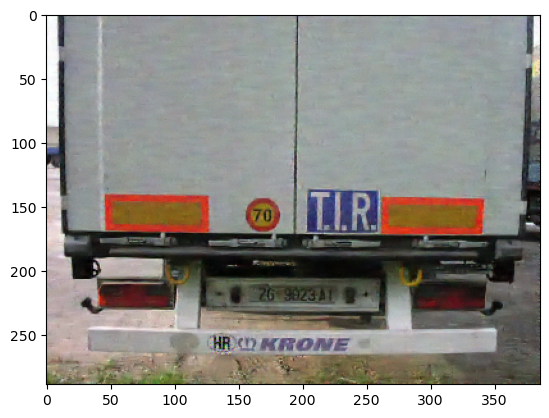

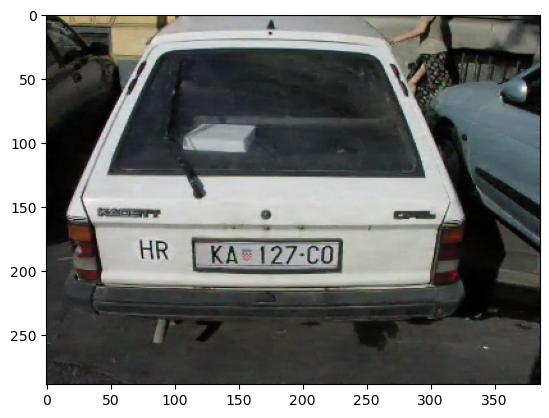

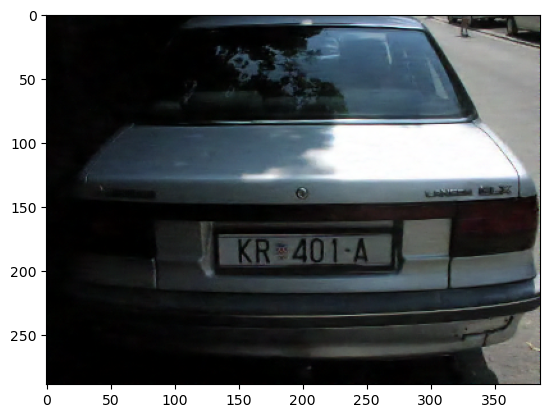

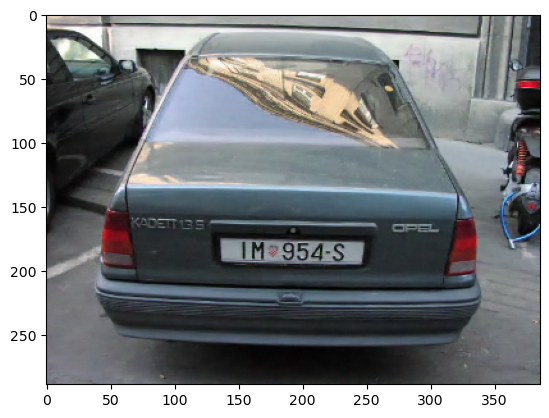

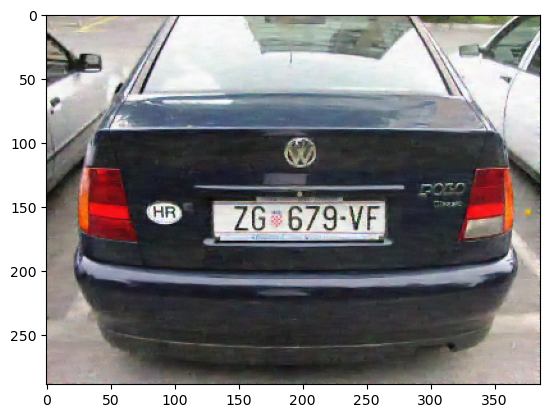

...

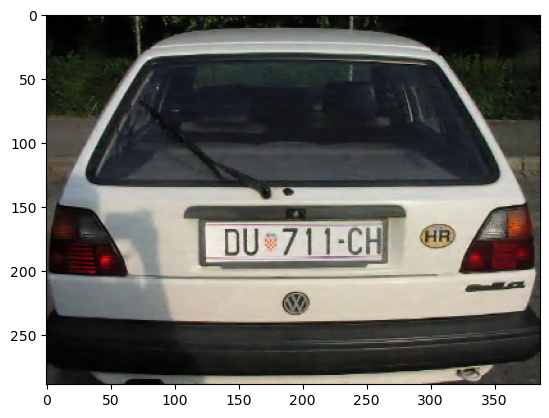

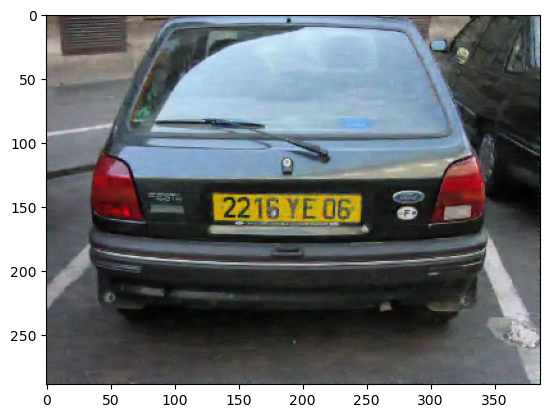

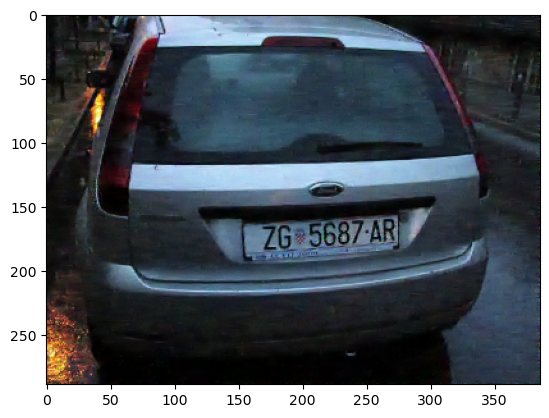

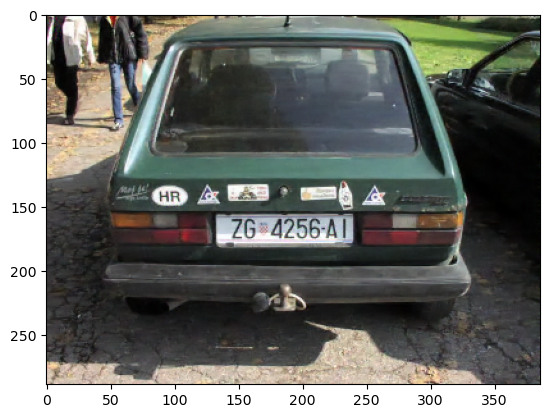

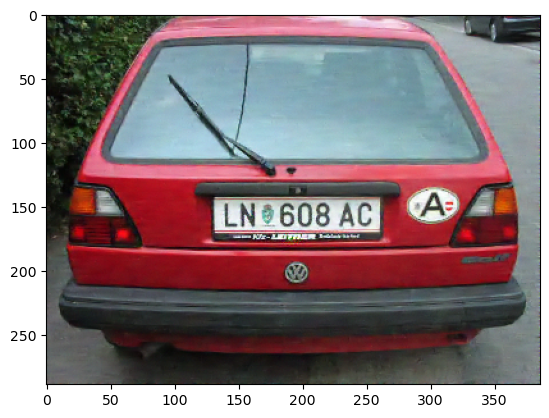

In [ ]:
# Testing
outputsTest = testing(testDataload, testDataloadNoise, model, criterion, weightPathComb)

for i, batch in enumerate(outputsTest):
    for j in range(batch.size(0)):
        img = batch[j].detach().cpu().clamp(0, 1)
        img = img.permute(1, 2, 0).numpy()  # [C, H, W] -> [H, W, C]
        plt.figure()
        plt.imshow(img)
